In [8]:
from netZooPy.panda import Panda
from netZooPy.lioness import Lioness

AttributeError: module 'pandas' has no attribute 'compat'

map motif to genes

In [62]:
# mapping=dict(pd.read_csv('TF_info2.txt',sep=' ').values)
mapping=dict(pd.read_csv('cisbp_nams_689_unique_hgnc_symbol.txt',sep='\t').values) ## works better

# iterator =  pd.read_csv('../../case_out_SPpanda.txt',chunksize=1000000,header=None,names=['name'])
iterator =  pd.read_csv('links.txt',chunksize=1000000,sep=' ',header=None,names=['name','whatever'])
for chunk in iterator:
    updated = chunk.assign(name=chunk.name.apply(lambda x: mapping.get(x,x)))  # This gives you updated names
    updated.to_csv('case_SP_tr.tsv',sep='\t', mode='a')

bash notes for meme suite

In [ ]:
%%bash
bash ./analyses/LTCOPD_panda/comp_PA.sh
cut -f1,2,4 --delimiter=' ' case_EXPpanda.txt > w_case_Epanda.txt
pr -mt analyses/SPIDER/case/case_out_SPpanda.txt  analyses/SPIDER/control/cont_out_SPpanda.txt > ca_co_SPpanda.txt ##cat files
awk '{ $7 = $4 - $6 } 1' ca_co_w_SPpanda.txt > ca_co_SPdiff.txt ##diff subtract files
cut -f1,2,7 --delimiter=' ' ca_co_SPdiff.txt > w_ca_co_SPdiff.txt
##threshold link weight difference
awk '(NR>1) && ($3 > 1 ) ' w_ca_co_SPdiff.txt  > thresh_w_ca_co_SP.txt 
awk '($3 < -.5) || ($3 > .5 ) ' analyses/SPIDER/w_case-cont_trSPpanda.txt > analyses/SPIDER/thresh5_c-c_trSP.txt
awk '($3 < -.5) || ($3 > .5 ) ' analyses/LTCOPD_panda/w_ca_co_EXdiff.txt > analyses/LTCOPD_panda/thresh5_c-c.txt
sed 1i‘source target weight’ thr_w_ca_co_SP.txt
##remove columns
awk '{$6=$8=""; print $0}' file
##Remove first row
cat motif3.txt | tail -n +2 >motif4.txt
##concatenate columns of files together
paste motif3.txt SPIDERmeth1_zero_controls.pairs | awk '{print $1,$3,$4}' > SPm_0_control.pairs
##split string into columns
less PAlink05.txt | awk '{split($0,a,"__"); print a[1],a[2]}' > PAlink05b.txt

### awk replace string matching list 
awk 'FNR==NR{a[$1]=$2;next} {for (i in a)sub(i, a[i]);print}' file1 file2
## awk 'FNR==NR{a[$1]=$2;next} {for (i in a)sub(i, a[i]);print}' Homo_sapiens_motifinfo.txt ../SPIDER/SPIDERmeth1_zero_ALL.pairs > SPall.pairs
### average of column 7 of all files
awk '{s+=$7}END{print s/NR}' c* > result.txt


In [67]:
import os
# os.chdir('~/')
# os.chdir("../SPIDER")
os.getcwd()

'/udd/redmo/analyses/SPIDER'

In [ ]:
from glob import glob
import numpy as np
for i in ("../SPIDER/case/lioness_output/*.npy"):
    a = np.load(i)
    np.savetxt(i,a,delimiter="\t")

# begin case v control LM

In [1]:
import numpy as np
import collections
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd
# import holoviews as hv
# hv.extension('bokeh')
from sklearn.linear_model import LinearRegression

In [58]:
case_young=(37,18,20,21,30,17,23,78,53,103,4,40,62,65,71,42)
case_old=(28,50,58,67,9,74,107,82,106,101)
control_young=(10,3,36,21,2,20,32,33,27)
control_old=(5,9,28,19,11,13,17,29,8,37,39,35,6)

In [ ]:
import os
import numpy as np
new = np.empty([690*25627,1])
# for i in case_young:
for i in os.listdir("/udd/redmo/analyses/SPIDER/case/case_young"):
    x=np.loadtxt(i,delimiter='\t')
#     x=np.reshape(x,(690*25627,1))
#     np.savetxt(('tr_'+str(i)),x,delimiter="\t")
    new = np.concatenate([new,x],axis=1)

model networks

# spider ZERO

## CONTROL

In [4]:
%%bash
less PA_cont_age05_c.txt | awk '{split($0,a,"__"); print a[1],a[2]}' > PAc_temp01.txt
cut -f1,2,3 PAc_temp01.txt > PAc_temp02.txt
##split string into columns
# less PA_cont_age05_b.txt | awk '{split($0,a,"__"); print a[1],a[2],a[3]}' > PAc_temp02.txt
# os.remove("PAc_temp01.txt")

##concatenate columns of files together
cat PAc_temp02.txt | tail -n +2 >PAc_temp03.txt

paste PAc_temp03.txt control/cont_SP_00.txt | awk '{print $1,$2,$3,$7}' > PA_cont_age05_fin.txt
# os.remove("PAc_temp02.txt")
awk '($3 < .05) ' PA_cont_age05_fin.txt > trPA_cont_age05_fin.txt
cut -f1,2,4 --delimiter=' ' trPA_cont_age05_fin.txt > trPA_cont_age05_fin2.txt
awk 'NF == 3' trPA_cont_age05_fin2.txt > PA_cont_age_05_d.txt
rm PA_cont_age05_fin.txt PAc_temp01.txt PAc_temp02.txt PAc_temp03.txt trPA_cont_age05_fin.txt  trPA_cont_age05_fin2.txt


Process is interrupted.


In [5]:
G=nx.read_weighted_edgelist('PA_cont_age_05_d.txt')
P=np.loadtxt('PA_cont_age_05_d.txt',dtype='str')
(np.unique(P[:,1:2])).size, (np.unique(P[:,2:3])).size

(3306, 205450)

In [ ]:
hv.extension('bokeh')
# nx.draw_networkx(G, pos=nx.spring_layout(G)) 
fb_graph=hv.HoloMap({i: hv.Graph.from_networkx(Q, nx.spring_layout, iterations=i, seed=10) for i in range(5, 30, 5)},
           kdims='Iterations')
# fb_graph=hv.Graph.from_networkx(G, nx. layout.bipartite_layout(G,np.unique(P[:,1:2])))
colors = ['#000000']+hv.Cycle('Category20').values
fb_graph = fb_graph.redim.range(x=(-0.05, 1.05),y=(-0.05, 1.05))
fb_graph.opts(color_index='circle', width=800, height=800, show_frame=False,node_line_color='gray',
                 xaxis=None, yaxis=None,node_size=10, edge_line_width=1, cmap=colors)
# hv.extension('matplotlib')
# hv.output(fig='svg')
# fb_graph.opts(
#     cmap='tab20', node_color=['#000000'], fig_size=350, padding=0.1,
#     show_frame=False, xaxis=None, yaxis=None, node_size=10)

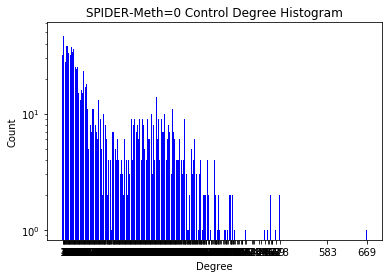

In [12]:
degree_sequence = sorted([d for n, d in Q.degree()], reverse=True)  # degree sequence
# print "Degree sequence", degree_sequence
degreeCount = collections.Counter(degree_sequence)
deg, cnt = zip(*degreeCount.items())

fig, ax = plt.subplots()
plt.bar(deg, cnt, width=0.80, color='b')

plt.title("SPIDER-Meth=0 Control Degree Histogram")
plt.ylabel("Count")
plt.xlabel("Degree")
ax.set_xticks([d + 0.4 for d in deg])
ax.set_xticklabels(deg)
ax.set_yscale('log')
# plt.axes([0.4, 0.4, 0.5, 0.5])
# Gcc = G.subgraph(sorted(nx.connected_components(G), key=len, reverse=True)[0])
# pos = nx.spring_layout(G)
# plt.axis('off')
# nx.draw_networkx_nodes(G, pos, node_size=20)
# nx.draw_networkx_edges(G, pos, alpha=0.4)

plt.show()

## CASE

In [9]:
%%bash
less PA_case_age05_c.txt | awk '{split($0,a,"__"); print a[1],a[2]}' > PAc_temp01.txt
cut -f1,2,3 PAc_temp01.txt > PAc_temp02.txt
##split string into columns
# less PA_case_age05_b.txt | awk '{split($0,a,"__"); print a[1],a[2],a[3]}' > PAc_temp02.txt
# os.remove("PAc_temp01.txt")

##concatenate columns of files together
cat PAc_temp02.txt | tail -n +2 >PAc_temp03.txt

paste PAc_temp03.txt case/case_SP_00.txt | awk '{print $1,$2,$3,$7}' > PA_case_age05_fin.txt
# os.remove("PAc_temp02.txt")
awk '($3 < .05) ' PA_case_age05_fin.txt > trPA_case_age05_fin.txt
cut -f1,2,4 --delimiter=' ' trPA_case_age05_fin.txt > trPA_case_age05_fin2.txt
awk 'NF == 3' trPA_case_age05_fin2.txt > PA_case_age_05_d.txt
rm PA_case_age05_fin.txt PAc_temp01.txt PAc_temp02.txt PAc_temp03.txt trPA_case_age05_fin.txt  trPA_case_age05_fin2.txt


Process is interrupted.


In [7]:
GG=nx.read_weighted_edgelist('PA_case_age_05_d.txt')
PP=np.loadtxt('PA_case_age_05_d.txt',dtype='str')
(np.unique(PP[:,1:2])).size, (np.unique(PP[:,2:3])).size

(2450, 170366)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
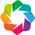

:HoloMap   [Iterations]
   :Graph   [start,end]   (weight)

In [94]:
hv.extension('bokeh')
# nx.draw_networkx(G, pos=nx.spring_layout(G)) 
fb_graph=hv.HoloMap({i: hv.Graph.from_networkx(QQ, nx.spring_layout, iterations=i, seed=10) for i in range(5, 30, 5)},
           kdims='Iterations')
# fb_graph=hv.Graph.from_networkx(G, nx. layout.bipartite_layout(G,np.unique(P[:,1:2])))
colors = ['#000000']+hv.Cycle('Category20').values
fb_graph = fb_graph.redim.range(x=(-0.05, 1.05),y=(-0.05, 1.05))
fb_graph.opts(color_index='circle', width=800, height=800, show_frame=False,node_line_color='gray',
                 xaxis=None, yaxis=None,node_size=10, edge_line_width=1, cmap=colors)

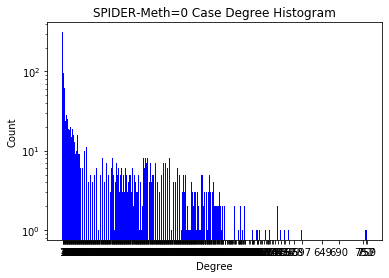

In [11]:
degree_sequence = sorted([d for n, d in QQ.degree()], reverse=True)  # degree sequence
# print "Degree sequence", degree_sequence
degreeCount = collections.Counter(degree_sequence)
deg, cnt = zip(*degreeCount.items())

fig, ax = plt.subplots()
plt.bar(deg, cnt, width=0.80, color='b')

plt.title("SPIDER-Meth=0 Case Degree Histogram")
plt.ylabel("Count")
plt.xlabel("Degree")
ax.set_xticks([d + 0.4 for d in deg])
ax.set_xticklabels(deg)
ax.set_yscale('log')
# plt.axes([0.4, 0.4, 0.5, 0.5])
# Gcc = G.subgraph(sorted(nx.connected_components(G), key=len, reverse=True)[0])
# pos = nx.spring_layout(G)
# plt.axis('off')
# nx.draw_networkx_nodes(G, pos, node_size=20)
# nx.draw_networkx_edges(G, pos, alpha=0.4)

plt.show()

In [8]:
Q=G.subgraph(GG.nodes)
QQ=GG.subgraph(G.nodes)
# Q=Q.subgraph(QQ.nodes)

In [9]:
QQ.nodes==Q.nodes

True

# DIFF

In [13]:
bb=nx.disjoint_union(Q,QQ)
cc=nx.intersection(Q,QQ)
dd=nx.difference(Q,QQ)
ee=nx.difference(QQ,Q)
eee=nx.symmetric_difference(QQ,Q)


In [14]:
for u,v,d in cc.edges(data=True):
    cc[u][v]['color']='red'
for u,v,d in dd.edges(data=True):
    dd[u][v]['color']='blue'
for u,v,d in ee.edges(data=True):
    ee[u][v]['color']='yellow'
ff=nx.compose_all([cc,dd,ee])

In [15]:
ff.edges(data=True)
edges,colors = zip(*nx.get_edge_attributes(ff,'color').items())


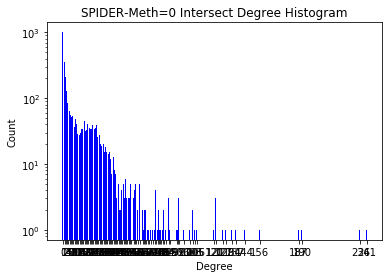

In [16]:
degree_sequence = sorted([d for n, d in cc.degree()], reverse=True)  # degree sequence
# print "Degree sequence", degree_sequence
degreeCount = collections.Counter(degree_sequence)
deg, cnt = zip(*degreeCount.items())

fig, ax = plt.subplots()
plt.bar(deg, cnt, width=0.80, color='b')

plt.title("SPIDER-Meth=0 Intersect Degree Histogram")
plt.ylabel("Count")
plt.xlabel("Degree")
ax.set_xticks([d + 0.4 for d in deg])
ax.set_xticklabels(deg)
ax.set_yscale('log')

# plt.axes([0.4, 0.4, 0.5, 0.5])
# Gcc = G.subgraph(sorted(nx.connected_components(G), key=len, reverse=True)[0])
# pos = nx.spring_layout(G)
# plt.axis('off')
# nx.draw_networkx_nodes(G, pos, node_size=20)
# nx.draw_networkx_edges(G, pos, alpha=0.4)

plt.show()

In [17]:
from matplotlib_venn_wordcloud import venn2_wordcloud

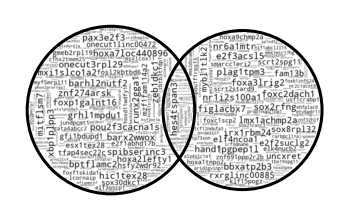

In [18]:
sets = []
for string in [QQ.edges, Q.edges]:

    # get a word list
    words = string

    # remove non alphanumeric characters
    words = [''.join(ch for ch in word if ch.isalnum()) for word in words]

    # convert to all lower case
    words = [word.lower() for word in words]

    sets.append(set(words))

# create visualisation
venn2_wordcloud(sets, )

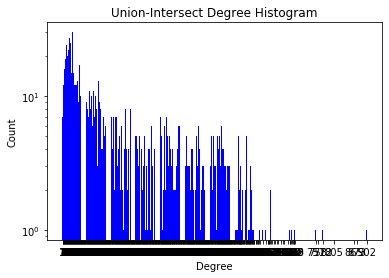

In [19]:
degree_sequence = sorted([d for n, d in eee.degree()], reverse=True)  # degree sequence
# print "Degree sequence", degree_sequence
degreeCount = collections.Counter(degree_sequence)
deg, cnt = zip(*degreeCount.items())

fig, ax = plt.subplots()
plt.bar(deg, cnt, width=0.80, color='b')

plt.title("Union-Intersect Degree Histogram")
plt.ylabel("Count")
plt.xlabel("Degree")
ax.set_xticks([d + 0.4 for d in deg])
ax.set_xticklabels(deg)
ax.set_yscale('log')

# plt.axes([0.4, 0.4, 0.5, 0.5])
# Gcc = G.subgraph(sorted(nx.connected_components(G), key=len, reverse=True)[0])
# pos = nx.spring_layout(G)
# plt.axis('off')
# nx.draw_networkx_nodes(G, pos, node_size=20)
# nx.draw_networkx_edges(G, pos, alpha=0.4)

plt.show()

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
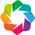

:HoloMap   [Iterations]
   :Graph   [start,end]   (color)

In [42]:
hv.extension('bokeh')
# nx.draw_networkx(G, pos=nx.spring_layout(G)) 
fb_graph=hv.HoloMap({i: hv.Graph.from_networkx(cc, nx.spring_layout, iterations=i, seed=10) for i in range(5, 30, 5)},
           kdims='Iterations')
# fb_graph=hv.Graph.from_networkx(G, nx. layout.bipartite_layout(G,np.unique(P[:,1:2])))
# colors = ['#000000']+hv.Cycle('Category20').values
# fb_graph = fb_graph.redim.range(x=(-0.05, 1.05),y=(-0.05, 1.05))
fb_graph.opts( width=1000, height=1000, show_frame=False,node_line_color='gray',edge_line_color='red',
                 xaxis=None, yaxis=None,node_size=5, edge_line_width=1)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
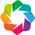

ERROR:bokeh.core.validation.check:E-1001 (BAD_COLUMN_NAME): Glyph refers to nonexistent column name. This could either be due to a misspelling or typo, or due to an expected column being missing. : key "line_color" value "colors" [renderer: GlyphRenderer(id='1048', ...)]


:HoloMap   [Iterations]
   :Graph   [start,end]   (color)

In [12]:
hv.extension('bokeh')
# nx.draw_networkx(G, pos=nx.spring_layout(G)) 
fb_graph=hv.HoloMap({i: hv.Graph.from_networkx(ff, nx.spring_layout, iterations=i, seed=10) for i in range(5, 30, 5)},
           kdims='Iterations')
# fb_graph=hv.Graph.from_networkx(G, nx. layout.bipartite_layout(G,np.unique(P[:,1:2])))
# colors = ['#000000']+hv.Cycle('Category20').values
# fb_graph = fb_graph.redim.range(x=(-0.05, 1.05),y=(-0.05, 1.05))
fb_graph.opts(width=800, height=800, show_frame=False,edge_color='colors',
                 xaxis=None, yaxis=None,node_size=10, edge_line_width=1)

In [17]:
from graph_tool.all import *

ModuleNotFoundError: No module named 'graph_tool'

In [15]:
import sys
print(sys.executable)
print(sys.version)
print(sys.version_info)

/Users/redmo/opt/anaconda3/bin/python
3.7.4 (default, Aug 13 2019, 15:17:50) 
[Clang 4.0.1 (tags/RELEASE_401/final)]
sys.version_info(major=3, minor=7, micro=4, releaselevel='final', serial=0)


In [22]:
import os
# os.chdir('..')
os.chdir("../LTCOPD_panda/case/lioness_output/")
os.getcwd()

'/Users/redmo/mountchan/analyses/LTCOPD_panda/case/lioness_output'

In [ ]:
#!/bin/bash
lionnet="lioness_output/"
mfiles=$(ls $lionnet)

less ../PA_case_age05_g.txt | awk '{split($0,a,"__"); print a[1],a[2]}' > PAc_temp01.txt
cut -f1,2,3,4 PAc_temp01.txt > PAc_temp02.txt
##split string into columns
# less PA_case_age05_b.txt | awk '{split($0,a,"__"); print a[1],a[2],a[3]}' > PAc_temp02.txt
# os.remove("PAc_temp01.txt")

##concatenate columns of files together
cat PAc_temp02.txt | tail -n +2 >PAc_temp03.txt
# mkdir $outdir
for mfile in $mfiles
do
    paste PAc_temp03.txt $lionnet$mfile | awk '{print $1,$2,$3,$4,$5}' > PA_case_age05_fin.txt
    # os.remove("PAc_temp02.txt")
    awk '($4 < .05) ' PA_case_age05_fin.txt > trPA_case_age05_fin.txt
    cut -f1,2,5 --delimiter=' ' trPA_case_age05_fin.txt > trPA_case_age05_fin2.txt
    eval "awk 'NF == 3' trPA_case_age05_fin2.txt > " outdir/$mfile
done
rm PA_case_age05_fin.txt PAc_temp01.txt PAc_temp02.txt PAc_temp03.txt trPA_case_age05_fin.txt  trPA_case_age05_fin2.txt


In [ ]:
prior=pd.read_csv('MotifPriors/MotifPriorRefSeq_mQTL_p4_-750_250.txt',sep='\t',names=['TF','gene','CG']) ## works better

In [ ]:
betas=pd.read_csv('betas.clean_1436199620_V13.txt',sep=';')

In [4]:
import requests
import os

In [5]:
url = 'https://grand.networkmedicine.org/api/v1/cellapi/';
cells = webread(url);
cells.results(1)

NameError: name 'webread' is not defined

### maybe need to put into case and control groups

In [3]:
import os
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from netZooPy.panda import Panda
from netZooPy.lioness import Lioness
from netZooPy.milipeed import Milipeed
from IPython.display import Image

In [5]:
%%bash
cat ../../analyses/MILIPEED/gene_exp_v14b.txt | tail -n +2 >../../analyses/MILIPEED/gene_exp_v14d.txt


In [94]:
panda_obj=Panda('/udd/redmo/analyses/MILIPEED/gene_exp_v14d.txt',
         '/udd/redmo/analyses/MILIPEED/wMotifPrior.txt',
         '/udd/redmo/analyses/MILIPEED/ppi.txt', keep_expression_matrix=True,modeProcess='intersection')

Loading motif data ...
  Elapsed time: 0.47 sec.
Loading expression data ...
Expression matrix: (25627, 151)
  Elapsed time: 1.02 sec.
Loading PPI data ...
Number of PPIs: 84388
  Elapsed time: 0.04 sec.
(15116, 151)
(25627, 151)
Calculating coexpression network ...
  Elapsed time: 9.87 sec.
Creating motif network ...
  Elapsed time: 0.61 sec.
Creating PPI network ...
  Elapsed time: 0.09 sec.
Normalizing networks ...
  Elapsed time: 43.47 sec.
Saving expression matrix and normalized networks ...
  Elapsed time: 0.12 sec.
Running PANDA algorithm ...
step: 0, hamming: 1.0656184873807781
step: 1, hamming: 0.33830723853050426
step: 2, hamming: 0.2248251606058381
step: 3, hamming: 0.1779825037464158
step: 4, hamming: 0.15077795203329003
step: 5, hamming: 0.13141696814092857
step: 6, hamming: 0.11579922968304596
step: 7, hamming: 0.10228389398313245
step: 8, hamming: 0.09018347015437309
step: 9, hamming: 0.07920859314262133
step: 10, hamming: 0.06923895485323399
step: 11, hamming: 0.0602198

In [4]:
os.chdir('../..')
os.getcwd()

'/Users/redmo'

In [5]:
# analysis=pd.read_csv('/udd/redmo/analyses/MILIPEED/lioness.gwas.10.03.2020.txt',sep='\t',skiprows=range(3,2500,3),header=0,index_col=0) 
analysis=pd.read_csv('analyses/MILIPEED/milipeed_gwas_1age_14.03.2020.txt',sep='\t',skiprows=range(3,2500,3),header=0,index_col=0)

analysis=analysis[(analysis.Intercept.str.contains('Intercept')==False)]
analysis=analysis.drop_duplicates()
link=analysis[analysis.index.str.contains('coeff')]
pval=analysis[analysis.index.str.contains('pval')]
pval=pval.apply(pd.to_numeric)
link=link.apply(pd.to_numeric)
pval = pval.mask(pval < .05)
plinks=np.multiply(link,pval)
del plinks['Intercept']
wlinks2=plinks.iloc[:,0:33]

In [38]:
wlinks2['sex[T.M]']=(wlinks2['sex[T.M]']-np.min(wlinks2['sex[T.M]']))/(np.max(wlinks2['sex[T.M]'])-np.min(wlinks2['sex[T.M]']))
wlinks2['age']=(wlinks2['age']-np.min(wlinks2['age']))/(np.max(wlinks2['age'])-np.min(wlinks2['age']))
wlinks2['FEV1']=(wlinks2['FEV1']-np.min(wlinks2['FEV1']))/(np.max(wlinks2['FEV1'])-np.min(wlinks2['FEV1']))
wlinks2['BMI']=(wlinks2['BMI']-np.min(wlinks2['BMI']))/(np.max(wlinks2['BMI'])-np.min(wlinks2['BMI']))
wlinks2['packyears']=(wlinks2['packyears']-np.min(wlinks2['packyears']))/(np.max(wlinks2['packyears'])-np.min(wlinks2['packyears']))


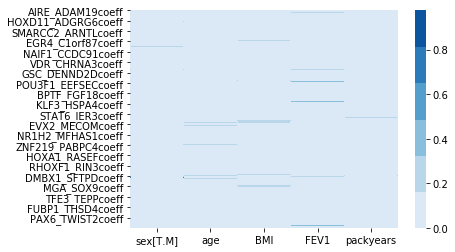

In [39]:
import seaborn as sns
# del plinks['sex[T.M]'], plinks['BMI'], plinks['FEV1'], plinks['packyears']
# flatui = ["#9b59b6", "#3498db", "#95a5a6", "#e74c3c", "#34495e", "#2ecc71"]
sns.heatmap(wlinks2[wlinks2<1],cmap=sns.color_palette("Blues"))

In [7]:
# analysis=pd.read_csv('/udd/redmo/analyses/MILIPEED/lioness.gwas.10.03.2020.txt',sep='\t',skiprows=range(3,2500,3),header=0,index_col=0) 
analysis=pd.read_csv('analyses/MILIPEED/lioness_gwas_1age_14.03.2020.txt',sep='\t',skiprows=range(3,2500,3),header=0,index_col=0)

analysis=analysis[(analysis.Intercept.str.contains('Intercept')==False)]
analysis=analysis.drop_duplicates()
link=analysis[analysis.index.str.contains('coeff')]
pval=analysis[analysis.index.str.contains('pval')]
pval=pval.apply(pd.to_numeric)
link=link.apply(pd.to_numeric)
pval = pval.mask(pval < .05)
plinks=np.multiply(link,pval)
del plinks['Intercept']
wlinks=plinks.iloc[:,0:33]


In [34]:
wlinks['sex[T.M]']=(wlinks['sex[T.M]']-np.min(wlinks['sex[T.M]']))/(np.max(wlinks['sex[T.M]'])-np.min(wlinks['sex[T.M]']))
wlinks['age']=(wlinks['age']-np.min(wlinks['age']))/(np.max(wlinks['age'])-np.min(wlinks['age']))
wlinks['FEV1']=(wlinks['FEV1']-np.min(wlinks['FEV1']))/(np.max(wlinks['FEV1'])-np.min(wlinks['FEV1']))
wlinks['BMI']=(wlinks['BMI']-np.min(wlinks['BMI']))/(np.max(wlinks['BMI'])-np.min(wlinks['BMI']))
wlinks['packyears']=(wlinks['packyears']-np.min(wlinks['packyears']))/(np.max(wlinks['packyears'])-np.min(wlinks['packyears']))


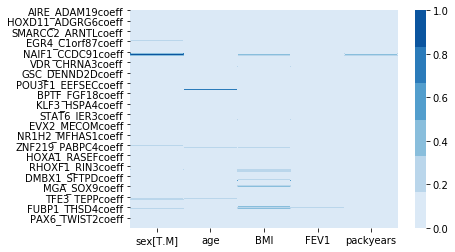

In [35]:
import seaborn as sns
# del plinks['sex[T.M]'], plinks['BMI'], plinks['FEV1'], plinks['packyears']
# flatui = ["#9b59b6", "#3498db", "#95a5a6", "#e74c3c", "#34495e", "#2ecc71"]
sns.heatmap(wlinks,cmap=sns.color_palette("Blues"))

In [109]:
plinks['link']=plinks.index

plinks['TF']=(plinks['link'].str.split('_', expand=True).rename(columns=lambda x: f"string_{x+1}"))['string_1']
plinks['gene']=(plinks['link'].str.split('_', expand=True).rename(columns=lambda x: f"string_{x+1}"))['string_2']
plinks['gene']=plinks.gene.str.rstrip('coeff')
del plinks['link']

In [47]:
import networkx as nx
G=nx.from_pandas_edgelist(plinks, 'TF', 'gene', ['age[T.44.0]'])

In [42]:
gene='AIRE'
covar=['age','sex','bmi']
(str(gene)) + "~"+'+'.join(covar)

'AIRE~age+sex+bmi'